In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
import plotly.express as px
import plotly.figure_factory as ff
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from scipy import stats
import statsmodels.api as sm
import statsmodels.formula.api as smf
from statsmodels.stats import diagnostic
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.linear_model import LinearRegression, Ridge, SGDRegressor
from sklearn.model_selection import cross_validate
from pywaffle import Waffle
import numpy as np, scipy.stats as st

In [2]:
pd.options.display.max_columns = None

### Loading and wrangling data

In [3]:
PATH = './data/'

GROCERY_WARD = 'year_osward_grocery.csv'
GROCERY_BOROUGH = 'year_borough_grocery.csv'

DIABETES_WARD = 'diabetes_estimates_osward_2016.csv'
OBESITY_BOROUGH = 'london_obesity_borough_2012.csv'
CHILD_OBESITY_WARD = 'child_obesity_london_ward_2013-2014.csv'

MAPPING_BOROUGH_WARD = 'Mapping-template-london-ward-map-2018.xls'
MAPPING_CODE_BOROUGH = 'Mapping-template-for-London-boroughs.xls'

BOUNDARIES_BOROUGH = 'statistical-gis-boundaries-london/ESRI/London_Borough_Excluding_MHW.shp'

CONSUMER_EXPENDITURE_BOROUGH = 'detailed-borough-base.xls'
CHILDREN_POVERTY_BOROUGH = 'children-in-poverty.xls'
EARNINGS_BOROUGH = 'earnings-residence-borough.xlsx'

#### Grocery data

In [4]:
groceries_borough = pd.read_csv(PATH + GROCERY_BOROUGH, sep = ',', header = 0)
groceries_ward = pd.read_csv(PATH + GROCERY_WARD, sep = ',', header = 0)
# Remove areas with representativeness below 10%
groceries_borough = groceries_borough[groceries_borough['representativeness_norm'] >= 0.1]
groceries_ward = groceries_ward[groceries_ward['representativeness_norm'] >= 0.1]

#### Ward to borough mapping

In [5]:
mapping_ward_to_borough = pd.read_excel(PATH + MAPPING_BOROUGH_WARD, sheet_name = 'Ward Thematic Map',usecols = [0, 1, 2],
                                        names = ['Ward Code', 'Ward name', 'Borough name'])
mapping_code_to_borough = pd.read_excel(PATH + MAPPING_CODE_BOROUGH, sheet_name = 'Borough Thematic Map',usecols = [1, 2],
                                       names = ['Borough Code', 'Borough name'])
mapping_ward_to_borough = mapping_ward_to_borough.merge(mapping_code_to_borough, on = 'Borough name')
mapping_ward_to_borough = mapping_ward_to_borough.drop(columns = ['Ward name', 'Borough name'])

#### Health data

Some of the data (diabetes) are only available for borough, thus we average all wards part of a same borough and map the data to the corresponding borough.

In [6]:
# Diabetes
diabetes_ward = pd.read_csv(PATH + DIABETES_WARD, sep = ',', header = 0)
diabetes_ward = diabetes_ward.merge(mapping_ward_to_borough, left_on = 'area_id', right_on = 'Ward Code')
diabetes_ward = diabetes_ward.drop(columns = ['Ward Code'])
diabetes_borough = diabetes_ward.groupby(['Borough Code'], as_index = False).mean()

In [7]:
# Obesity
obesity_borough = pd.read_csv(PATH + OBESITY_BOROUGH, sep = ',', header = 0)

In [8]:
# Child obesity ward
child_obesity_ward = pd.read_csv(PATH + CHILD_OBESITY_WARD, sep = ',', header = 0)
to_drop = child_obesity_ward[ (child_obesity_ward['prevalence_overweight_reception'] == 'na')
                             | (child_obesity_ward['prevalence_overweight_y6'] == 'na')
                            | (child_obesity_ward['prevalence_obese_reception'] == 'na')
                            | (child_obesity_ward['prevalence_obese_y6'] == 'na')].index
child_obesity_ward.drop(to_drop , inplace=True)
child_obesity_ward = child_obesity_ward.merge(mapping_ward_to_borough, left_on = 'area_id', right_on = 'Ward Code')
child_obesity_ward = child_obesity_ward.drop(columns = ['Ward Code'])
child_obesity_ward = child_obesity_ward.astype({'number_reception_measured': 'float64',
          'number_y6_measured': 'float64',
          'prevalence_overweight_reception': 'float64',
          'prevalence_overweight_y6': 'float64',
          'prevalence_obese_reception': 'float64',
          'prevalence_obese_y6': 'float64'})
child_obesity_borough = child_obesity_ward.groupby(['Borough Code'], as_index = False).mean()

We merge data for wards

In [9]:
merged_ward = pd.merge(diabetes_ward, groceries_ward, how = 'inner', left_index = False, on='area_id')
merged_ward.head()

,area_id,gp_patients,gp_patients_diabetes,estimated_diabetes_prevalence,Borough Code,weight,weight_perc2.5,weight_perc25,weight_perc50,weight_perc75,weight_perc97.5,weight_std,weight_ci95,volume,volume_perc2.5,volume_perc25,volume_perc50,volume_perc75,volume_perc97.5,volume_std,volume_ci95,fat,fat_perc2.5,fat_perc25,fat_perc50,fat_perc75,fat_perc97.5,fat_std,fat_ci95,saturate,saturate_perc2.5,saturate_perc25,saturate_perc50,saturate_perc75,saturate_perc97.5,saturate_std,saturate_ci95,salt,salt_perc2.5,salt_perc25,salt_perc50,salt_perc75,salt_perc97.5,salt_std,salt_ci95,sugar,sugar_perc2.5,sugar_perc25,sugar_perc50,sugar_perc75,sugar_perc97.5,sugar_std,sugar_ci95,protein,protein_perc2.5,protein_perc25,protein_perc50,protein_perc75,protein_perc97.5,protein_std,protein_ci95,carb,carb_perc2.5,carb_perc25,carb_perc50,carb_perc75,carb_perc97.5,carb_std,carb_ci95,fibre,fibre_perc2.5,fibre_perc25,fibre_perc50,fibre_perc75,fibre_perc97.5,fibre_std,fibre_ci95,alcohol,alcohol_perc2.5,alcohol_perc25,alcohol_perc50,alcohol_perc75,alcohol_perc97.5,alcohol_std,alcohol_ci95,energy_fat,energy_fat_perc2.5,energy_fat_perc25,energy_fat_perc50,energy_fat_perc75,energy_fat_perc97.5,energy_fat_std,energy_fat_ci95,energy_saturate,energy_saturate_perc2.5,energy_saturate_perc25,energy_saturate_perc50,energy_saturate_perc75,energy_saturate_perc97.5,energy_saturate_std,energy_saturate_ci95,energy_sugar,energy_sugar_perc2.5,energy_sugar_perc25,energy_sugar_perc50,energy_sugar_perc75,energy_sugar_perc97.5,energy_sugar_std,energy_sugar_ci95,energy_protein,energy_protein_perc2.5,energy_protein_perc25,energy_protein_perc50,energy_protein_perc75,energy_protein_perc97.5,energy_protein_std,energy_protein_ci95,energy_carb,energy_carb_perc2.5,energy_carb_perc25,energy_carb_perc50,energy_carb_perc75,energy_carb_perc97.5,energy_carb_std,energy_carb_ci95,energy_fibre,energy_fibre_perc2.5,energy_fibre_perc25,energy_fibre_perc50,energy_fibre_perc75,energy_fibre_perc97.5,energy_fibre_std,energy_fibre_ci95,energy_alcohol,energy_alcohol_perc2.5,energy_alcohol_perc25,energy_alcohol_perc50,energy_alcohol_perc75,energy_alcohol_perc97.5,energy_alcohol_std,energy_alcohol_ci95,energy_tot,energy_tot_perc2.5,energy_tot_perc25,energy_tot_perc50,energy_tot_perc75,energy_tot_perc97.5,energy_tot_std,energy_tot_ci95,f_energy_fat,f_energy_saturate,f_energy_sugar,f_energy_protein,f_energy_carb,f_energy_fibre,f_energy_alcohol,energy_density,h_nutrients_weight,h_nutrients_weight_norm,h_nutrients_calories,h_nutrients_calories_norm,f_beer,f_dairy,f_eggs,f_fats_oils,f_fish,f_fruit_veg,f_grains,f_meat_red,f_poultry,f_readymade,f_sauces,f_soft_drinks,f_spirits,f_sweets,f_tea_coffee,f_water,f_wine,f_dairy_weight,f_eggs_weight,f_fats_oils_weight,f_fish_weight,f_fruit_veg_weight,f_grains_weight,f_meat_red_weight,f_poultry_weight,f_readymade_weight,f_sauces_weight,f_sweets_weight,h_items,h_items_norm,h_items_weight,h_items_weight_norm,representativeness_norm,transaction_days,num_transactions,man_day,population,male,female,age_0_17,age_18_64,age_65+,avg_age,area_sq_km,people_per_sq_km
0,E05000026,13136,1068,8.1,E09000002,449.535137,32.5,166.4,300.0,500.0,1500.0,771.349423,3.716832,125.960833,11.00,45.000,90.0,200.0,340.8,114.892118,1.127239,9.488797,0.0,0.2,2.4,14.1,50.5,15.119655,0.057529,3.693721,0.0,0.1,0.8,4.3,21.0,6.714925,0.025550,0.583240,0.0,0.01,0.20,0.80,2.4,2.239420,0.008521,10.966213,0.0,1.4,4.4,11.8,58.5,16.636405,0.063300,4.977560,0.0,0.4,2.8,7.6,23.4,6.156284,0.023424,19.381951,0.0,0.3,8.2,32.2,73.5,23.859315,0.090782,1.564721,0.0,0.0,1.0,2.2,7.3,2.323645,0.008841,0.198172,0.0,0.0,0.0,0.0,0.0,1.692997,0.006442,85.399176,0.0,1.8,21.6,126.9,454.5,136.076899,0.517759,33.243489,0.0,0.9,7.2,38.7,189.0,60.434321,0.229946,43.864852,0.0,5.6,17.6,47.2,234.0,66.545619,0.253199,19.910240,0.0,1.6,11.2,30.4,93.6,24.625135,0.093696,77.527804,0.0,1.2,32.8,128.8,294.0,95.437261,0.363129,2.890336,0.0,0.0,1.6,4.4,14.4,4.436731,0.016881,1.387201,0.0,0.0,0.0,0.0,0.0,11.850977,0.045092,187.114757,0.0,41.

We merge data for boroughs

In [10]:
merged = pd.merge(groceries_borough, obesity_borough, how = 'inner', left_index = False, left_on='area_id',
                         right_on = 'oslaua')
merged = pd.merge(merged, child_obesity_borough, how = 'inner', left_index = False, left_on='area_id',
                         right_on = 'Borough Code')
merged_borough = pd.merge(merged, diabetes_borough, how = 'inner', left_index = False, left_on='area_id',
                         right_on = 'Borough Code')
merged_borough.head()

,area_id,weight,weight_perc2.5,weight_perc25,weight_perc50,weight_perc75,weight_perc97.5,weight_std,weight_ci95,volume,volume_perc2.5,volume_perc25,volume_perc50,volume_perc75,volume_perc97.5,volume_std,volume_ci95,fat,fat_perc2.5,fat_perc25,fat_perc50,fat_perc75,fat_perc97.5,fat_std,fat_ci95,saturate,saturate_perc2.5,saturate_perc25,saturate_perc50,saturate_perc75,saturate_perc97.5,saturate_std,saturate_ci95,salt,salt_perc2.5,salt_perc25,salt_perc50,salt_perc75,salt_perc97.5,salt_std,salt_ci95,sugar,sugar_perc2.5,sugar_perc25,sugar_perc50,sugar_perc75,sugar_perc97.5,sugar_std,sugar_ci95,protein,protein_perc2.5,protein_perc25,protein_perc50,protein_perc75,protein_perc97.5,protein_std,protein_ci95,carb,carb_perc2.5,carb_perc25,carb_perc50,carb_perc75,carb_perc97.5,carb_std,carb_ci95,fibre,fibre_perc2.5,fibre_perc25,fibre_perc50,fibre_perc75,fibre_perc97.5,fibre_std,fibre_ci95,alcohol,alcohol_perc2.5,alcohol_perc25,alcohol_perc50,alcohol_perc75,alcohol_perc97.5,alcohol_std,alcohol_ci95,energy_fat,energy_fat_perc2.5,energy_fat_perc25,energy_fat_perc50,energy_fat_perc75,energy_fat_perc97.5,energy_fat_std,energy_fat_ci95,energy_saturate,energy_saturate_perc2.5,energy_saturate_perc25,energy_saturate_perc50,energy_saturate_perc75,energy_saturate_perc97.5,energy_saturate_std,energy_saturate_ci95,energy_sugar,energy_sugar_perc2.5,energy_sugar_perc25,energy_sugar_perc50,energy_sugar_perc75,energy_sugar_perc97.5,energy_sugar_std,energy_sugar_ci95,energy_protein,energy_protein_perc2.5,energy_protein_perc25,energy_protein_perc50,energy_protein_perc75,energy_protein_perc97.5,energy_protein_std,energy_protein_ci95,energy_carb,energy_carb_perc2.5,energy_carb_perc25,energy_carb_perc50,energy_carb_perc75,energy_carb_perc97.5,energy_carb_std,energy_carb_ci95,energy_fibre,energy_fibre_perc2.5,energy_fibre_perc25,energy_fibre_perc50,energy_fibre_perc75,energy_fibre_perc97.5,energy_fibre_std,energy_fibre_ci95,energy_alcohol,energy_alcohol_perc2.5,energy_alcohol_perc25,energy_alcohol_perc50,energy_alcohol_perc75,energy_alcohol_perc97.5,energy_alcohol_std,energy_alcohol_ci95,energy_tot,energy_tot_perc2.5,energy_tot_perc25,energy_tot_perc50,energy_tot_perc75,energy_tot_perc97.5,energy_tot_std,energy_tot_ci95,f_energy_fat,f_energy_saturate,f_energy_sugar,f_energy_protein,f_energy_carb,f_energy_fibre,f_energy_alcohol,energy_density,h_nutrients_weight,h_nutrients_weight_norm,h_nutrients_calories,h_nutrients_calories_norm,f_beer,f_dairy,f_eggs,f_fats_oils,f_fish,f_fruit_veg,f_grains,f_meat_red,f_poultry,f_readymade,f_sauces,f_soft_drinks,f_spirits,f_sweets,f_tea_coffee,f_water,f_wine,f_dairy_weight,f_eggs_weight,f_fats_oils_weight,f_fish_weight,f_fruit_veg_weight,f_grains_weight,f_meat_red_weight,f_poultry_weight,f_readymade_weight,f_sauces_weight,f_sweets_weight,h_items,h_items_norm,h_items_weight,h_items_weight_norm,representativeness_norm,transaction_days,num_transactions,man_day,population,male,female,age_0_17,age_18_64,age_65+,avg_age,area_sq_km,people_per_sq_km,oslaua,f_healthy_weight,f_overweight,f_obese,weighted_sample,Borough Code_x,number_reception_measured,number_y6_measured,prevalence_overweight_reception,prevalence_overweight_y6,prevalence_obese_reception,prevalence_obese_y6,Borough Code_y,gp_patients,gp_patients_diabetes,estimated_diabetes_prevalence
0,E09000002,421.304125,32.5,165.6,300.0,500.0,1500.0,597.994271,0.828993,122.341294,11.0,47.1,90.0,175.0,340.8,115.859833,0.351870,9.209959,0.0,0.2,2.4,13.9,48.2,14.478662,0.016131,3.596834,0.0,0.1,0.8,4.1,20.5,6.466539,0.007205,0.603081,0.0,0.03,0.20,0.80,2.4,2.168270,0.002416,10.793244,0.0,1.3,4.1,11.8,58.5,16.635331,0.018534,5.193872,0.0,0.4,3.0,7.9,23.5,6.274192,0.006990,19.784988,0.0,0.4,8.7,33.6,75.3,24.192629,0.026954,1.590335,0.0,0.0,1.0,2.2,7.5,2.451484,0.002731,0.202540,0.0,0.0,0.0,0.0,0.00,1.767156,0.001969,82.889630,0.0,1.8,21.6,125.1,433.8,130.307956,0.145182,32.371503,0.0,0.9,7.2,36.9,184.5,58.198855,0.064842,43.172978,0.0,5.2,16.4,47.2,234.0,66.541322,0.074136,20.775486,0.0,1.6,12

#### Map visualization data

We load and merge boundaries

In [11]:
map_borough = gpd.read_file(BOUNDARIES_BOROUGH)
merged = map_borough.merge(merged_borough, left_on = 'GSS_CODE', right_on = 'area_id', how = 'inner')

#### Economic data

In [12]:
# Children poverty
children_poverty = pd.read_excel(PATH+CHILDREN_POVERTY_BOROUGH, sheet_name = '2015',usecols = [0, 5],
                                        names = ['area_id', 'child_poverty'])
children_poverty = children_poverty.loc[21:53]
children_poverty = children_poverty.astype({'child_poverty': 'float64'})

In [13]:
# Earnings
earnings = pd.read_excel(PATH+EARNINGS_BOROUGH, sheet_name = 'Full-time, Weekly',usecols = [1, 28],
                                       names = ['Borough name', 'earnings'], na_values=['#'])
earnings = earnings.loc[2:34]
earnings = earnings.astype({'earnings': 'float64'})

In [14]:
# Consumer expenditures
consumer_expenditure = pd.read_excel(PATH+CONSUMER_EXPENDITURE_BOROUGH, sheet_name = 'Greater London',usecols = [0, 1, 17],
                                        names = ['Borough name', 'type', 'expenditure'], skiprows=[0, 1, 2])
consumer_expenditure.dropna(inplace=True)
consumer_expenditure.sort_values(by=['Borough name'], inplace=True)
consumer_expenditure = consumer_expenditure.pivot_table(values='expenditure', index='Borough name', columns='type')
consumer_expenditure.rename(index={'Barking & Dagenham':'Barking and Dagenham', 
                                   'Hammersmith & Fulham':'Hammersmith and Fulham',
                                   'Kensington & Chelsea':'Kensington and Chelsea'}, inplace=True)

In [15]:
# Transform the absolute expenditures as a fraction of the total expenditures
consumer_expenditure = consumer_expenditure.transform(lambda x: (x*100 / x.sum()), axis=1)
consumer_expenditure.head()

type,Actual rentals for housing,Alcoholic beverages,Audio-visual,Clothing and footwear,Education,"Electricity, gas & other fuels",Financial services not elsewhere classified,Food,Furniture & Textiles,Household Goods and Services,Imputed rentals for housing,Insurance,Maintenance and repair of the dwelling,Medical Products,Medical Services,Newspapers,Non-alcoholic beverages,Operation of personal transport equipment,Other major durables for recreation and culture,Other recreational items and equipment,Other services n.e.c.,Personal care,Personal effects n.e.c.,Postal services,Purchase of vehicles,Recreational and cultural services,Restaurants and hotels,Social protection,Telecommunications Services,Tobacco,Transport services,Water supply and miscellaneous services relating to the
Borough name,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Barking and Dagenham,8.401319,1.228408,2.777925,6.296320,1.262735,2.631579,4.284000,8.061614,2.083657,2.144005,15.845472,1.785000,1.768501,1.066146,0.826250,0.916655,1.096186,4.286183,0.070175,2.129805,0.573086,2.223312,0.821333,0.087629,3.334053,3.257603,8.797959,1.380546,2.446971,1.824482,5.183534,1.107555
Barnet,5.256095,1.192891,1.888448,5.573847,3.182274,3.054838,3.103746,6.066519,2.099825,2.205048,20.711028,1.641321,1.189410,1.024064,1.047413,0.869222,0.826756,4.090824,1.779850,2.114577,0.492655,2.054177,1.380539,0.096023,3.023916,2.910999,10.233001,1.672460,1.829000,0.723944,5.889130,0.776161
Bexley,4.097689,1.337614,2.445697,6.022974,1.370368,2.944338,3.761359,7.548195,2.375199,2.486363,19.167076,1.902306,1.554746,1.055718,0.981952,0.994825,0.947928,5.088781,0.319895,2.406830,0.492508,2.220943,1.307200,0.119722,4.117496,3.355656,9.430117,1.544546,1.989204,1.066547,4.521306,1.024901
Brent,8.813684,1.154166,2.258782,6.163107,1.878693,2.839752,3.540338,7.157549,2.111664,2.085394,18.122519,1.699568,1.406546,1.031701,0.908822,0.816218,1.020502,3.968956,0.521406,1.961109,0.500636,2.061413,0.997338,0.082891,3.112354,2.932636,9.527248,1.522964,2.297018,1.120621,5.484342,0.900064
Bromley,4.015113,1.252118,2.179819,5.669783,2.594342,2.930991,3.164375,6.559214,2.225919,2.365402,20.979982,1.770274,1.295823,1.034591,1.066813,0.918292,0.847052,4.561057,1.285745,2.308471,0.477911,2.103586,1.336850,0.107308,3.617541,3.106077,10.015356,1.527817,1.791617,0.789299,5.230287,0.871176


### Visualize prevalence of diabetes and obesity/overweight

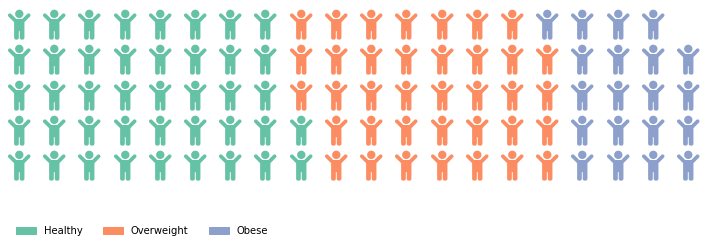

In [16]:
# Waffle plot visualization of the proportion of healthy, overweight and obese people
data = obesity_borough.mean().loc[["f_healthy_weight", "f_overweight", "f_obese"]]
fig = plt.figure(
    FigureClass=Waffle,
    rows=5,
    values= data,
    labels=['Healthy', 'Overweight', 'Obese'],
    legend={'loc': 'lower left', 'bbox_to_anchor': (0, -0.4), 'ncol': len(data), 'framealpha': 0},
    icons='child',
    font_size=30,
    figsize=(10, 5)
)
plt.savefig("figures/obesity.svg", pad_inches=0, bbox_inches = 'tight')

We check if there's a correlation between the indicators we look at

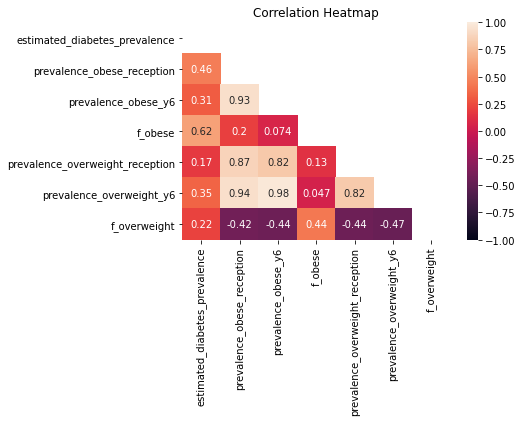

In [17]:
indicators = ['estimated_diabetes_prevalence', 'prevalence_obese_reception', 'prevalence_obese_y6','f_obese', 'prevalence_overweight_reception', 'prevalence_overweight_y6', 'f_overweight']
df = merged_borough[indicators]
# Heatmap of the Spearman rank correlations between indicators
mask = np.triu(np.ones_like(df.corr(), dtype=np.bool))
heatmap = sns.heatmap(df.corr(method='spearman'), vmin=-1, vmax=1, mask = mask, annot=True)
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':12});

We check if those indicators are correlated with any food habits

In [18]:
# We partition 'types' of food habits
energy_nutrients = ['energy_tot', 'energy_fat', 'energy_saturate', 'energy_sugar', 'energy_protein', 'energy_carb', 
                    'energy_fibre', 'energy_alcohol', 'h_nutrients_calories']
f_food_categories = ['f_beer', 'f_dairy', 'f_eggs', 'f_fats_oils', 'f_fish', 'f_fruit_veg', 'f_grains',
                   'f_meat_red', 'f_poultry', 'f_readymade', 'f_sauces', 'f_soft_drinks', 'f_spirits',
                   'f_sweets', 'f_tea_coffee', 'f_water', 'f_wine']
weight_categories = ['f_dairy_weight', 'f_eggs_weight', 'f_fats_oils_weight', 'f_fish_weight',
                    'f_fruit_veg_weight', 'f_grains_weight', 'f_meat_red_weight', 'f_poultry_weight',
                    'f_readymade_weight', 'f_sauces_weight',
                   'f_sweets_weight']

We plot some correlations between features and health indicators just for the sake of visualization.
Here we only look at energy_nutrients, f_food_categories as features and estimated_diabetes_prevalence and f_overweight as health indicators to represent the global trend.

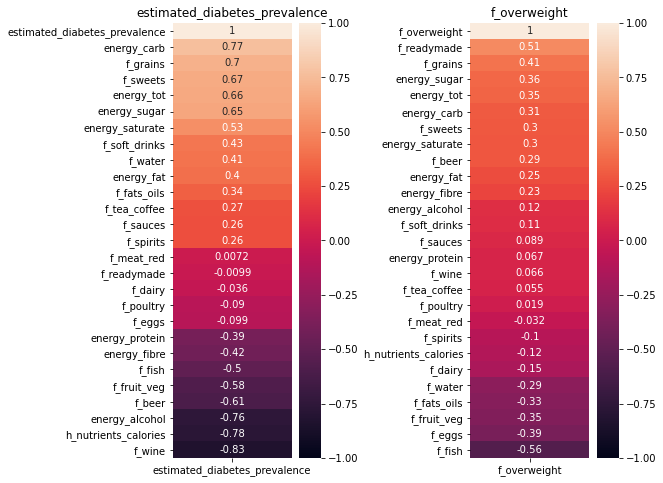

In [19]:
# Select features and indicators to correlate
features = energy_nutrients + f_food_categories
indicators = ['estimated_diabetes_prevalence', 'f_overweight']

# Plot Spearman rank correlations between selected features and indicators
fig, axs = plt.subplots(nrows=1, ncols=2, sharex=False, sharey=False, figsize=(8, 8))

for i, ind in enumerate(indicators):
    labels = features.copy()
    labels.append(ind)
    df = merged_borough[labels]
    heatmap = sns.heatmap(df.corr(method='spearman')[[ind]].sort_values(by = ind, ascending=False), vmin=-1, vmax=1, annot=True, ax=axs[i])
    heatmap.set_title(ind, fontdict={'fontsize':12})
    
plt.subplots_adjust(wspace=1)

We plot a more detailed view on the Spearman rank correlations between the energy from the different nutrients and the energy from the different food categories, with all the health related indicators considered in this work. 

In [20]:
# All the health related indicators
indicators = ['prevalence_obese_reception', 'prevalence_obese_y6', 'f_obese', 'prevalence_overweight_reception', 'prevalence_overweight_y6', 'f_overweight', 'estimated_diabetes_prevalence']
indicator_labels = ['Prevalence obese reception', 'Prevalence obese y6', 'Fraction obese', 'Prevalence overweight reception', 'Prevalence overweight y6', 'Fraction overweight', 'Estimated diabetes prevalence']

In [21]:
# Labels for interactive heatmap plot
nutrients_labels = ['Energy tot', 'Energy fat', 'Energy saturate', 'Energy sugar', 'Energy protein', 'Energy carb', 
                    'Energy fibre', 'Energy alcohol', 'Entropy energy nutrients']
food_labels = ['Beer', 'Dairy', 'Eggs', 'Fats & oils', 'Fish', 'Fruit & veg', 'Grains',
                   'Red meat', 'Poultry', 'Readymade', 'Sauces', 'Soft drinks', 'Spirits',
                   'Sweets', 'Tea & coffee', 'Water', 'Wine']

In [22]:
# Return a dataframe with the Spearman rank correlations and p-values for heatmap
def compute_corrs_to_plot(features, indicators, data):
    correlations = pd.DataFrame()
    for i in indicators:
        correlation = pd.DataFrame(columns = ['feature', 'R', 'p_value', 'significant'])
        for f in features:
            corr = stats.spearmanr(data[i], data[f])
            corr_data = pd.DataFrame([[f, corr[0], corr[1], corr[1]< 0.05]], columns = ['feature', 'R', 'p_value', 'significant'])
            correlation = correlation.append(corr_data, ignore_index = True)
        correlations = pd.concat([correlations, correlation], axis=0)
    return correlations

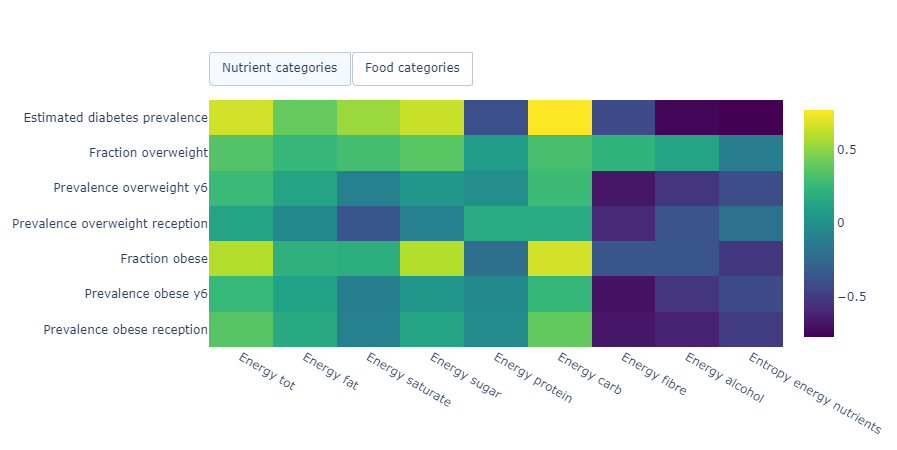

In [23]:
# Heatmap of correlations
plot = go.Figure(data=[go.Heatmap(
        z=compute_corrs_to_plot(energy_nutrients, indicators, merged_borough)['R'].values.reshape(len(indicators), len(nutrients_labels)).tolist(),
        x=nutrients_labels,
        y=indicator_labels,
        text=compute_corrs_to_plot(energy_nutrients, indicators, merged_borough)['p_value'].values.reshape(len(indicators), len(nutrients_labels)).tolist(),
        hovertemplate = "<b>%{x}</b><br>" + " and " + "<b>%{y}</b><br>" + "cor = " + "%{z}<br>" + "p-val = " + "%{text}<br>" + "<extra></extra>",
        colorscale='Viridis',
        visible=True
    
), 
    go.Heatmap(
        z=compute_corrs_to_plot(f_food_categories, indicators, merged_borough)['R'].values.reshape(len(indicators), len(food_labels)).tolist(),
        x=food_labels,
        y=indicator_labels,
        text=compute_corrs_to_plot(f_food_categories, indicators, merged_borough)['p_value'].values.reshape(len(indicators), len(food_labels)).tolist(),
        hovertemplate =  "<b>%{x}</b><br>" + " and " + "<b>%{y}</b><br>" + "cor = " + "%{z}<br>" + "p-val = " + "%{text}<br>" + "<extra></extra>",
        colorscale='Viridis',
        visible=False
)
])

plot.update_layout( 

    updatemenus=[ 
        dict(showactive=True,
             type="buttons",
             xanchor="left",
             yanchor="top",
             direction="right",
             x=0.0,
             y=1.2,
             active=0,
             visible=True,
            buttons=list([  
                dict(label="Nutrient categories", 
                     method="update", 
                     args=[{"visible": [True, False]}, 
                           ]), 
                dict(label="Food categories", 
                     method="update", 
                     args=[{"visible": [False, True]}, 
                           ]), 
            ]), 
        ) 
    ]) 

plot.write_html("figures/correlations.html")    
plot.show() 

### Visualize average diet

We plot nutrient and category repartition in average diet

In [24]:
# Average row-wise to get a global trend across London boroughs
average_nutrients = pd.DataFrame(groceries_ward.mean(axis = 0)[energy_nutrients], columns = ['nutrient'])
average_categories = pd.DataFrame(groceries_ward.mean(axis = 0)[f_food_categories], columns = ['category'])
average_weight_categories = pd.DataFrame(groceries_ward.mean(axis = 0)[weight_categories], columns = ['category'])

In [25]:
# Labels for plots
nutrients_labels = ['Fat', 'Saturate', 'Sugar', 'Protein', 'Carb', 
                    'Fibre', 'Alcohol']
food_labels = ['Beer', 'Dairy', 'Eggs', 'Fats & oils', 'Fish', 'Fruit & veg', 'Grains',
                   'Red meat', 'Poultry', 'Readymade', 'Sauces', 'Soft drinks', 'Spirits',
                   'Sweets', 'Tea & coffee', 'Water', 'Wine']
weight_food_labels = ['Dairy', 'Eggs', 'Fats & oils', 'Fish', 'Fruit & veg', 'Grains',
                   'Red meat', 'Poultry', 'Readymade', 'Sauces', 'Sweets']

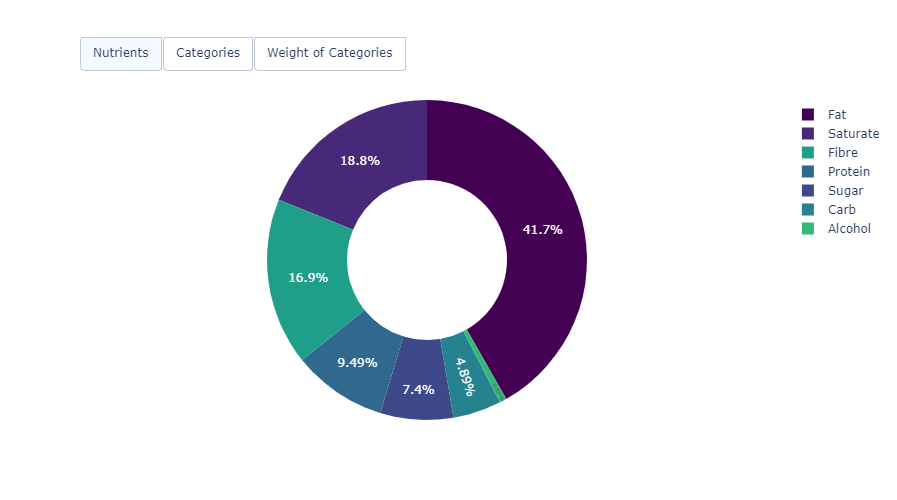

In [26]:
# Interactive pie chart
plot = go.Figure(data=[
    go.Pie( 
    name='Nutrients', 
    values=average_nutrients['nutrient'], 
    labels=nutrients_labels,
    marker_colors=px.colors.sequential.Viridis,
    textposition='inside',
    hoverinfo='percent+label',
    insidetextorientation='auto',
    hole=0.5
), 
    go.Pie( 
    name='Category', 
    values=average_categories['category'], 
    labels=food_labels,
    marker_colors=px.colors.sequential.Viridis,
    textposition='inside',
    hoverinfo='percent+label',
    insidetextorientation='auto',
    hole=0.5,
    visible = False
),
    go.Pie( 
    name='Weight of Category', 
    values=average_weight_categories['category'], 
    labels=weight_food_labels,
    marker_colors=px.colors.sequential.Viridis,
    textposition='inside',
    hoverinfo='percent+label',
    insidetextorientation='auto',
    hole=0.5,
    visible = False
)
])


plot.update_layout( 
    updatemenus=[ 
        dict(showactive=True,
             type="buttons",
             xanchor="left",
             yanchor="top",
             direction="right",
             x=0.0,
             y=1.2,
             visible=True,
            buttons=list([
                dict(label="Nutrients", 
                     method="update", 
                     args=[{"visible": [True, False, False]}, ]), 
                dict(label="Categories", 
                     method="update", 
                     args=[{"visible": [False, True, False]}, ]),
                dict(label="Weight of Categories", 
                     method="update", 
                     args=[{"visible": [False, False, True]}, ]), 
            ]),
             active=0
        ) 
    ], width = 500, height = 500) 

plot.write_html("figures/piecharts.html")
plot.show() 

### Compare each area's diet to the WHO recommendations

We compute 3 criterias that make a diet healthy and that are either 0 or 1 depending on if they are fulfilled or not

In [27]:
# Total fat should not exceed 30% of total energy intake
groceries_borough['WHO_totalfat'] = 0
groceries_borough.loc[(groceries_borough['energy_fat'] <= 0.3*groceries_borough['energy_tot']), 'WHO_totalfat'] = 1
groceries_borough['WHO_totalfat'].sum() / groceries_borough.shape[0]

0.0

In [28]:
# Intake of saturated fats should be less than 10% of total energy intake
groceries_borough['WHO_saturatedfat'] = 0
groceries_borough.loc[(groceries_borough['energy_saturate'] <= 0.1*groceries_borough['energy_tot']), 'WHO_saturatedfat'] = 1
groceries_borough['WHO_saturatedfat'].sum() / groceries_borough.shape[0]

0.0

In [29]:
# Intake of free sugars should be less than 10% of total energy intake
groceries_borough['WHO_freesugars'] = 0
groceries_borough.loc[(groceries_borough['energy_fat'] <= 0.1*groceries_borough['energy_sugar']), 'WHO_freesugars'] = 1
groceries_borough['WHO_freesugars'].sum() / groceries_borough.shape[0]

0.0

### Compute a diet score

#### Method 1 : fit a linear regression on the overweight and obesity data with the highest correlated energy_nutrients features

In [30]:
# Fit the regression on all the indicators except diabetes
indicators = ['prevalence_obese_reception', 'prevalence_obese_y6', 'f_obese', 'prevalence_overweight_reception', 'prevalence_overweight_y6', 'f_overweight']

In [31]:
for i in indicators:
    correlation = pd.DataFrame(columns = ['feature', 'R', 'p_value'])
    for f in energy_nutrients:
        corr = stats.spearmanr(merged_borough[i], merged_borough[f])
        corr_data = pd.DataFrame([[f, corr[0], corr[1]]], columns = ['feature', 'R', 'p_value'])
        correlation = correlation.append(corr_data, ignore_index = True)
    sig_features = correlation[correlation['p_value'] < 0.05]
    print(i)
    print(sig_features)

prevalence_obese_reception
                feature         R   p_value
5           energy_carb  0.388718  0.049697
6          energy_fibre -0.680000  0.000133
7        energy_alcohol -0.630085  0.000561
8  h_nutrients_calories -0.496068  0.009955
prevalence_obese_y6
                feature         R   p_value
6          energy_fibre -0.699829  0.000069
7        energy_alcohol -0.536410  0.004729
8  h_nutrients_calories -0.416752  0.034178
f_obese
                feature         R   p_value
0            energy_tot  0.592681  0.001420
3          energy_sugar  0.592681  0.001420
5           energy_carb  0.667579  0.000195
8  h_nutrients_calories -0.521204  0.006327
prevalence_overweight_reception
        feature         R   p_value
6  energy_fibre -0.602051  0.001137
prevalence_overweight_y6
                feature         R   p_value
6          energy_fibre -0.684786  0.000114
7        energy_alcohol -0.537094  0.004666
8  h_nutrients_calories -0.413333  0.035831
f_overweight
Empty DataF

We only select the features with a statistically significant Spearman rank correlation (p < 0.05) with almost two indicators. As we have a small dataset, we want a very few but very relevant features for our model.

In [32]:
features = ['energy_carb', 'energy_fibre', 'h_nutrients_calories']

To find the weights of each feature, we fit a regressor that we train with a Stochastic Gradient Descent algorithm. We cross validate to find the optimal hyper-parameters.

In [33]:
# Method to fit the regression with cross-validation to find the optimal hyper-parameters
def find_weights(merged, label):
    X = merged[features]
    y = merged[label]
    scaler = StandardScaler()
    X = scaler.fit_transform(X)
    hyperparams = {'reg':[0.1, 0.01, 0.001, 0.0001], 'learning_rate':[0.1, 0.05, 0.01]}
    scenarios = []
    for lr in hyperparams['learning_rate']:
        for r in hyperparams['reg']:
            scores = cross_validate(SGDRegressor(alpha = r, eta0 = lr),X, y = y, cv = 3,
                             scoring=('explained_variance', 'neg_mean_squared_error', 'r2'))
            scenario = {'learning_rate':lr, 'regularizer':r,
                        'MSE': scores['test_neg_mean_squared_error'],
                        'Explained variance': scores['test_explained_variance'],
                       'r2' : scores['test_r2']}
            scenarios.append(scenario)

    best = np.argmax([np.mean(s['r2']) for s in scenarios])

    reg_opt = scenarios[best]['regularizer']
    lr_opt = scenarios[best]['learning_rate']
    model_opt = SGDRegressor(eta0 = lr_opt, alpha = reg_opt)
    model_opt.fit(X,y)
    r2 = model_opt.score(X, y)
    train_error = np.mean((model_opt.predict(X)-y)**2)
    prediction = model_opt.predict(X)
    print(label)
    print(("Training error : {}, R2 : {}").
          format(train_error, r2))
    return model_opt.coef_, prediction

In [34]:
# Fit the regression and store the coefficients
weights = pd.DataFrame(index = features, columns = indicators)

for label in indicators:
    weights[label],_ = find_weights(merged_borough, label)

prevalence_obese_reception
Training error : 0.00014423409564990277, R2 : 0.49213122192183345
prevalence_obese_y6
Training error : 0.0005271263693425126, R2 : 0.5084274240432929
f_obese
Training error : 10.693546294717716, R2 : 0.5074140121872173
prevalence_overweight_reception
Training error : 0.0002577601141370593, R2 : 0.3895205851577447
prevalence_overweight_y6
Training error : 0.0007670548747817051, R2 : 0.4578182165386785
f_overweight
Training error : 7.368529356736563, R2 : 0.23481718950217256


For the final weights, we average the weights for all the health indicators.

In [35]:
weights = weights.mean(axis = 1)

In [36]:
# Compute the score as the sum of the features of interest weigthed by their respective fitted coefficients
def score(area):
    df = area[features].values
    score = (df*weights).sum()
    return score

In [37]:
# Apply the score and the grocery data and rescale it
groceries_borough['score1'] = groceries_borough.apply(score, axis=1)
scaler = MinMaxScaler()
groceries_borough['score1'] = 1 - scaler.fit_transform(groceries_borough[['score1']].values.reshape(-1,1))

To check the consistency of our score, we plot the features of the 25% lowest and 25% highest scoring areas. The highest the score, the unhealthiest. Indeed, it predicts for health diseases prevalence.

In [38]:
lowest = pd.DataFrame(groceries_borough[groceries_borough['score1'] <= groceries_borough['score1'].quantile(0.25)][features]).T
highest = pd.DataFrame(groceries_borough[groceries_borough['score1'] >= groceries_borough['score1'].quantile(0.75)][features]).T

In [39]:
stats_lowest = pd.DataFrame()
stats_highest = pd.DataFrame()
for _, f in enumerate(features):
    lowest_err = st.t.interval(0.95, len(lowest.loc[f])-1, loc=lowest.loc[f].mean(), scale=st.sem(lowest.loc[f]))
    highest_err = st.t.interval(0.95, len(highest.loc[f])-1, loc=highest.loc[f].mean(), scale=st.sem(highest.loc[f]))
    lowest_err = pd.DataFrame([[lowest.loc[f].mean() - lowest_err[0], lowest_err[1] - lowest.loc[f].mean()]],
                              columns = ['error_minus', 'error_plus'])
    highest_err = pd.DataFrame([[highest.loc[f].mean() - highest_err[0], highest_err[1] - highest.loc[f].mean()]],
                               columns = ['error_minus', 'error_plus'])
    lowest_mean = pd.DataFrame([lowest.loc[f].mean()], columns = ['mean'])
    highest_mean = pd.DataFrame([highest.loc[f].mean()], columns = ['mean'])
    feature_lowest = pd.concat([lowest_mean, lowest_err], axis = 1)
    feature_highest = pd.concat([highest_mean, highest_err], axis = 1)
    stats_lowest = pd.concat([stats_lowest, feature_lowest], axis = 0)
    stats_highest = pd.concat([stats_highest, feature_highest], axis = 0)
stats_lowest.reset_index(inplace = True)
stats_highest.reset_index(inplace=True)

In [40]:
stats_lowest.reset_index(inplace = True)
stats_highest.reset_index(inplace=True)

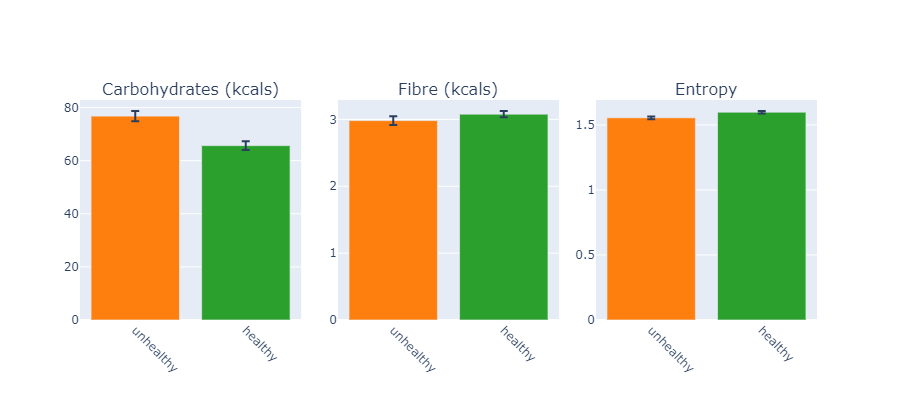

In [41]:
titles = ["Carbohydrates (kcals)", "Fibre (kcals)", "Entropy"]
fig = make_subplots(rows=1, cols=3, horizontal_spacing=0.05, vertical_spacing=0.1,
                   subplot_titles=(titles[0], titles[1], titles[2]))

def add_bar_subplot(col):
    fig.add_trace(go.Bar(
        x=[0, 1], 
        y=[stats_lowest.iloc[col]['mean'], stats_highest.iloc[col]['mean']],
        error_y=dict(type = "data", array =[stats_lowest.iloc[col].error_minus, stats_highest.iloc[col].error_minus]),
        marker_color=['#ff7f0e', '#2ca02c'],
        hovertemplate = titles[col] + ": %{y:.3f}<br>" + "<extra></extra>"),
        row=1, col=col+1)
    fig['layout']['xaxis'+str(col+1)].update(tickvals=[0,1], ticktext=['unhealthy', 'healthy'], tickangle=45)

                  
for i, f in enumerate(features):
    add_bar_subplot(i)

fig.update_layout(height=400, width=650, showlegend=False, title_font_size=3)
fig.write_html("figures/barplots_score1.html")
fig.show()

#### Method 2 : fit a linear regression on the obesity datasets with the most consumed f_food_categories features

In [42]:
# Take the 4 most consumed food categories
features = ['f_fruit_veg', 'f_sweets', 'f_grains', 'f_dairy']

In [43]:
# Fit the regression
weights = pd.DataFrame(index = features, columns = indicators)

for label in indicators:
    weights[label],_ = find_weights(merged_borough, label)

prevalence_obese_reception
Training error : 0.0002707708741089923, R2 : 0.04657721634223244
prevalence_obese_y6
Training error : 0.0007880505543073014, R2 : 0.26510213964796125
f_obese
Training error : 12.75464165935291, R2 : 0.4124720099567051
prevalence_overweight_reception
Training error : 0.00032510855309348475, R2 : 0.23001244813544364
prevalence_overweight_y6
Training error : 0.0012172017979685775, R2 : 0.13963829270657713
f_overweight
Training error : 8.069725010813599, R2 : 0.16200172859815876


In [44]:
weights = weights.mean(axis = 1)

We plot the features of the 25% lowest and 25% highest scoring areas to compare them.

In [45]:
groceries_borough['score2'] = groceries_borough.apply(score, axis=1)
scaler = MinMaxScaler()
groceries_borough['score2'] = 1 - scaler.fit_transform(groceries_borough[['score2']].values.reshape(-1,1))

In [46]:
lowest = pd.DataFrame(groceries_borough[groceries_borough['score2'] <= groceries_borough['score2'].quantile(0.25)][features]).T
highest = pd.DataFrame(groceries_borough[groceries_borough['score2'] >= groceries_borough['score2'].quantile(0.75)][features]).T

In [47]:
stats_lowest = pd.DataFrame()
stats_highest = pd.DataFrame()
for _, f in enumerate(features):
    lowest_err = st.t.interval(0.95, len(lowest.loc[f])-1, loc=lowest.loc[f].mean(), scale=st.sem(lowest.loc[f]))
    highest_err = st.t.interval(0.95, len(highest.loc[f])-1, loc=highest.loc[f].mean(), scale=st.sem(highest.loc[f]))
    lowest_err = pd.DataFrame([[lowest.loc[f].mean() - lowest_err[0], lowest_err[1] - lowest.loc[f].mean()]],
                              columns = ['error_minus', 'error_plus'])
    highest_err = pd.DataFrame([[highest.loc[f].mean() - highest_err[0], highest_err[1] - highest.loc[f].mean()]],
                               columns = ['error_minus', 'error_plus'])
    lowest_mean = pd.DataFrame([lowest.loc[f].mean()], columns = ['mean'])
    highest_mean = pd.DataFrame([highest.loc[f].mean()], columns = ['mean'])
    feature_lowest = pd.concat([lowest_mean, lowest_err], axis = 1)
    feature_highest = pd.concat([highest_mean, highest_err], axis = 1)
    stats_lowest = pd.concat([stats_lowest, feature_lowest], axis = 0)
    stats_highest = pd.concat([stats_highest, feature_highest], axis = 0)
stats_lowest.reset_index(inplace = True)
stats_highest.reset_index(inplace=True)

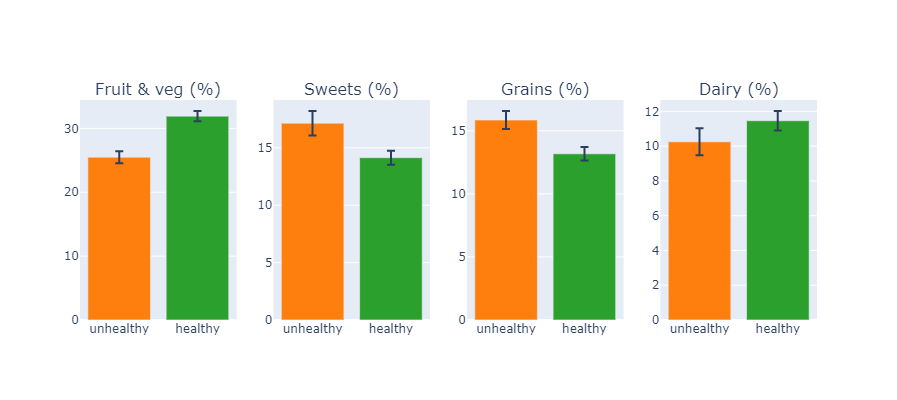

In [48]:
titles = ['Fruit & veg (%)', 'Sweets (%)', 'Grains (%)', 'Dairy (%)']
fig = make_subplots(rows=1, cols=4, horizontal_spacing=0.05, vertical_spacing=0.1,
                   subplot_titles=(titles[0], titles[1], titles[2], titles[3]))

def add_bar_subplot(col):
    fig.add_trace(go.Bar(
        x=[0, 1], 
        y=[stats_lowest.iloc[col]['mean']*100, stats_highest.iloc[col]['mean']*100],
        error_y=dict(type = "data", array =[stats_lowest.iloc[col].error_minus*100, stats_highest.iloc[col].error_minus*100]),
        marker_color=['#ff7f0e', '#2ca02c'],
        hovertemplate = titles[col] + ": %{y:.3f}<br>" + "<extra></extra>"),
        row=1, col=col+1)
    fig['layout']['xaxis'+str(col+1)].update(tickvals=[0,1], ticktext=['unhealthy', 'healthy'])

                  
for i, f in enumerate(features):
    add_bar_subplot(i)

fig.update_layout(height=400, width=650, showlegend=False)
fig.write_html("figures/barplots_score2.html")
fig.show()

### Map visualization of the two scores

In [49]:
def plot_london(variable, merged_borough):
    MAPBOX_ACCESSTOKEN = 'pk.eyJ1Ijoic29zbzk0IiwiYSI6ImNraTdwem80MDFsNXEyc3FzeGMxOHpoZGkifQ.coIFQU-pN6pZJi0GuXnLVw'
    merged = map_borough.merge(merged_borough, left_on = 'GSS_CODE', right_on = 'area_id', how = 'inner')
    merged = merged.to_crs(epsg=4326) # convert the coordinate reference system to lat/long
    lga_json = merged.__geo_interface__ #covert to geoJSON
    zmin = merged[variable].min()
    zmax = merged[variable].max()
    name = merged['NAME']

    # Set the data for the map
    data = go.Choroplethmapbox(
            geojson = lga_json,             #this is your GeoJSON
            locations = merged.index,    #the index of this dataframe should align with the 'id' element in your geojson
            z = merged[variable], #sets the color value
            text = merged.NAME,    #sets text for each shape
            colorbar=dict(thickness=20, ticklen=3, tickformat='',outlinewidth=0), #adjusts the format of the colorbar
            marker_line_width=1, marker_opacity=0.7, colorscale="Viridis", #adjust format of the plot
            zmin=zmin, zmax=zmax,           #sets min and max of the colorbar
            hovertemplate = "<b>%{text}</b><br>" +
                             "%{z:.0%}<br>" +
                            "<extra></extra>")  # sets the format of the text shown when you hover over each shape

    # Set the layout for the map
    layout = go.Layout(     #format the plot title
        mapbox1 = dict(
            domain = {'x': [0, 1],'y': [0, 1]}, 
            center = dict(lat=51.509865 , lon=-0.118092),
            accesstoken = MAPBOX_ACCESSTOKEN, 
            zoom = 8.8),                      
        autosize=True,
        height=650,
        margin=dict(l=0, r=0, t=40, b=0))

    # Generate the map
    data, layout
    fig=go.Figure(data=data, layout=layout)
    fig.write_image("figures/" + variable + "_map.jpeg")
    fig.show()

### Validation of the two score and selection of the best one

In [50]:
merged_borough = pd.merge(merged_borough, groceries_borough[['area_id', 'score1', 'score2']], on='area_id')

In [51]:
merged_borough[['estimated_diabetes_prevalence', 'score1', 'score2']].corr(method='spearman')

,estimated_diabetes_prevalence,score1,score2
estimated_diabetes_prevalence,1.000000,-0.767521,-0.610256
score1,-0.767521,1.000000,0.948718
score2,-0.610256,0.948718,1.000000


Scores 1 and 2 are strongly positively correlated, which is coherent as they try to capture the same information. 
Both scores are also strongly negatively correlated with diabetes prevalence, as expected, but the correlation is stronger for the score 1.

We now plot the relationship between both scores, and between each score and diabetes prevalence to validate our model. 

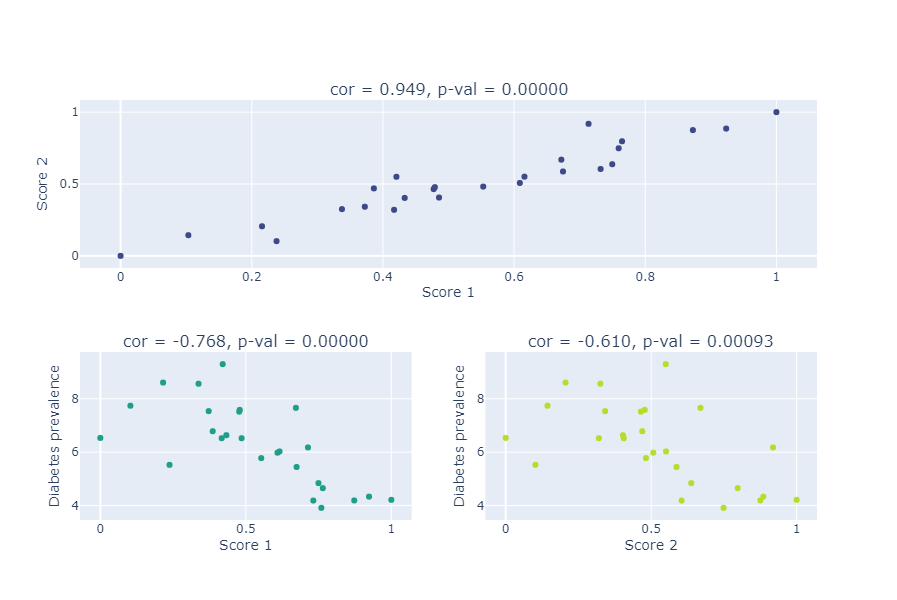

In [52]:
# Features to plot in scatter plots
features = ['score1', 'score2', 'estimated_diabetes_prevalence']
features_name = ['Score 1', 'Score 2', 'Diabetes prevalence']
colors = ['#3e4989', '#1f9e89', '#b5de2b']

# Correlations between the features
cor0, pval0 = stats.spearmanr(merged_borough['score1'], merged_borough['score2'])
cor1, pval1 = stats.spearmanr(merged_borough['score1'], merged_borough['estimated_diabetes_prevalence'])
cor2, pval2 = stats.spearmanr(merged_borough['score2'], merged_borough['estimated_diabetes_prevalence'])
titles = [f'cor = {cor0:.3f}, p-val = {pval0:.5f}',
         f'cor = {cor1:.3f}, p-val = {pval1:.5f}',
        f'cor = {cor2:.3f}, p-val = {pval2:.5f}']    

fig = make_subplots(rows=2, cols=2, horizontal_spacing=0.1, vertical_spacing=0.2,
                specs=[[{"colspan": 2}, None], [{}, {}]],
                   subplot_titles=(titles[0], titles[1], titles[2]))

# Scatter plot
def add_scatter_subplot(f1, f2, row, col):
    fig.add_trace(go.Scatter(
        x=merged_borough[features[f1]], 
        y=merged_borough[features[f2]],
        marker_color = colors[row+col-2],
        mode='markers',
        hovertemplate = features_name[f1] + ": %{x:.4f}<br>" + features_name[f2] + ": %{y:.4f}<br>" + "<extra></extra>"),
        row=row, col=col)
    fig['layout']['xaxis'+str(row+col-1)].update(title_text=features_name[f1], title_standoff=3)
    fig['layout']['yaxis'+str(row+col-1)].update(title_text=features_name[f2], title_standoff=3)
    
add_scatter_subplot(0, 1, 1, 1)
add_scatter_subplot(0, 2, 2, 1)
add_scatter_subplot(1, 2, 2, 2)

fig.update_layout(height=600, width=650, showlegend=False)
fig.write_html("figures/scatter2d.html")
fig.show()

As score1 has a biggest Spearman rank correlation coefficient than score2, we will only use score1 in our future analyses.

### Relate the diet score to economic factors

We first plot the 10 main sources of expenditures averaged over boroughs

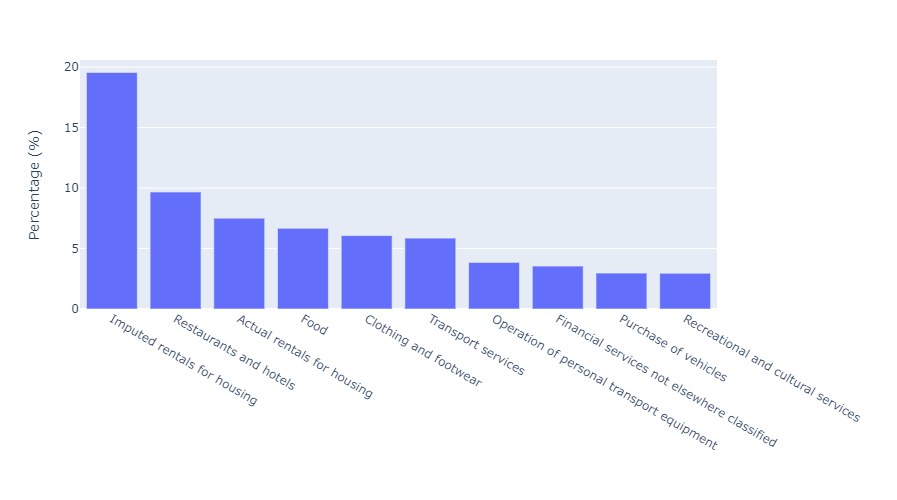

In [53]:
# Bar plot of the main food expenditures
fig = px.bar(consumer_expenditure.mean().sort_values(ascending = False)[:10])
fig.update_layout(
    xaxis_title="",
    yaxis_title="Percentage (%)",
    showlegend = False,
    height = 500
)

fig.show()
fig.write_html("figures/food_expenditures.html")

We merge the economic data

In [54]:
groceries_poverty = pd.merge(groceries_borough, children_poverty, how = 'inner', on='area_id')

boroughs = mapping_code_to_borough.copy()
boroughs = pd.merge(boroughs, earnings, how='inner', on='Borough name')
groceries_earnings = pd.merge(groceries_borough, boroughs, how = 'inner', left_on='area_id', right_on='Borough Code')

boroughs = mapping_code_to_borough.copy()
boroughs = pd.merge(boroughs, consumer_expenditure['Food'], how='inner', on='Borough name')
groceries_expenditure = pd.merge(groceries_borough, boroughs, how = 'inner', left_on='area_id', right_on='Borough Code')
groceries_expenditure.rename(columns={'Food':'food_expenditure'}, inplace=True)

merged_borough = pd.merge(merged_borough, groceries_poverty[['area_id', 'child_poverty']], on='area_id')
merged_borough = pd.merge(merged_borough, groceries_earnings[['area_id', 'earnings']], on='area_id')
merged_borough = pd.merge(merged_borough, groceries_expenditure[['area_id', 'food_expenditure']], on='area_id')
merged_borough.head()

,area_id,weight,weight_perc2.5,weight_perc25,weight_perc50,weight_perc75,weight_perc97.5,weight_std,weight_ci95,volume,volume_perc2.5,volume_perc25,volume_perc50,volume_perc75,volume_perc97.5,volume_std,volume_ci95,fat,fat_perc2.5,fat_perc25,fat_perc50,fat_perc75,fat_perc97.5,fat_std,fat_ci95,saturate,saturate_perc2.5,saturate_perc25,saturate_perc50,saturate_perc75,saturate_perc97.5,saturate_std,saturate_ci95,salt,salt_perc2.5,salt_perc25,salt_perc50,salt_perc75,salt_perc97.5,salt_std,salt_ci95,sugar,sugar_perc2.5,sugar_perc25,sugar_perc50,sugar_perc75,sugar_perc97.5,sugar_std,sugar_ci95,protein,protein_perc2.5,protein_perc25,protein_perc50,protein_perc75,protein_perc97.5,protein_std,protein_ci95,carb,carb_perc2.5,carb_perc25,carb_perc50,carb_perc75,carb_perc97.5,carb_std,carb_ci95,fibre,fibre_perc2.5,fibre_perc25,fibre_perc50,fibre_perc75,fibre_perc97.5,fibre_std,fibre_ci95,alcohol,alcohol_perc2.5,alcohol_perc25,alcohol_perc50,alcohol_perc75,alcohol_perc97.5,alcohol_std,alcohol_ci95,energy_fat,energy_fat_perc2.5,energy_fat_perc25,energy_fat_perc50,energy_fat_perc75,energy_fat_perc97.5,energy_fat_std,energy_fat_ci95,energy_saturate,energy_saturate_perc2.5,energy_saturate_perc25,energy_saturate_perc50,energy_saturate_perc75,energy_saturate_perc97.5,energy_saturate_std,energy_saturate_ci95,energy_sugar,energy_sugar_perc2.5,energy_sugar_perc25,energy_sugar_perc50,energy_sugar_perc75,energy_sugar_perc97.5,energy_sugar_std,energy_sugar_ci95,energy_protein,energy_protein_perc2.5,energy_protein_perc25,energy_protein_perc50,energy_protein_perc75,energy_protein_perc97.5,energy_protein_std,energy_protein_ci95,energy_carb,energy_carb_perc2.5,energy_carb_perc25,energy_carb_perc50,energy_carb_perc75,energy_carb_perc97.5,energy_carb_std,energy_carb_ci95,energy_fibre,energy_fibre_perc2.5,energy_fibre_perc25,energy_fibre_perc50,energy_fibre_perc75,energy_fibre_perc97.5,energy_fibre_std,energy_fibre_ci95,energy_alcohol,energy_alcohol_perc2.5,energy_alcohol_perc25,energy_alcohol_perc50,energy_alcohol_perc75,energy_alcohol_perc97.5,energy_alcohol_std,energy_alcohol_ci95,energy_tot,energy_tot_perc2.5,energy_tot_perc25,energy_tot_perc50,energy_tot_perc75,energy_tot_perc97.5,energy_tot_std,energy_tot_ci95,f_energy_fat,f_energy_saturate,f_energy_sugar,f_energy_protein,f_energy_carb,f_energy_fibre,f_energy_alcohol,energy_density,h_nutrients_weight,h_nutrients_weight_norm,h_nutrients_calories,h_nutrients_calories_norm,f_beer,f_dairy,f_eggs,f_fats_oils,f_fish,f_fruit_veg,f_grains,f_meat_red,f_poultry,f_readymade,f_sauces,f_soft_drinks,f_spirits,f_sweets,f_tea_coffee,f_water,f_wine,f_dairy_weight,f_eggs_weight,f_fats_oils_weight,f_fish_weight,f_fruit_veg_weight,f_grains_weight,f_meat_red_weight,f_poultry_weight,f_readymade_weight,f_sauces_weight,f_sweets_weight,h_items,h_items_norm,h_items_weight,h_items_weight_norm,representativeness_norm,transaction_days,num_transactions,man_day,population,male,female,age_0_17,age_18_64,age_65+,avg_age,area_sq_km,people_per_sq_km,oslaua,f_healthy_weight,f_overweight,f_obese,weighted_sample,Borough Code_x,number_reception_measured,number_y6_measured,prevalence_overweight_reception,prevalence_overweight_y6,prevalence_obese_reception,prevalence_obese_y6,Borough Code_y,gp_patients,gp_patients_diabetes,estimated_diabetes_prevalence,score1,score2,child_poverty,earnings,food_expenditure
0,E09000002,421.304125,32.5,165.6,300.0,500.0,1500.0,597.994271,0.828993,122.341294,11.0,47.1,90.0,175.0,340.8,115.859833,0.351870,9.209959,0.0,0.2,2.4,13.9,48.2,14.478662,0.016131,3.596834,0.0,0.1,0.8,4.1,20.5,6.466539,0.007205,0.603081,0.0,0.03,0.20,0.80,2.4,2.168270,0.002416,10.793244,0.0,1.3,4.1,11.8,58.5,16.635331,0.018534,5.193872,0.0,0.4,3.0,7.9,23.5,6.274192,0.006990,19.784988,0.0,0.4,8.7,33.6,75.3,24.192629,0.026954,1.590335,0.0,0.0,1.0,2.2,7.5,2.451484,0.002731,0.202540,0.0,0.0,0.0,0.0,0.00,1.767156,0.001969,82.889630,0.0,1.8,21.6,125.1,433.8,130.307956,0.145182,32.371503,0.0,0.9,7.2,36.9,184.5,58.198855,0.064842,43.172978,0.0,5.2,1

We plot the relationship between earnings food expenditures

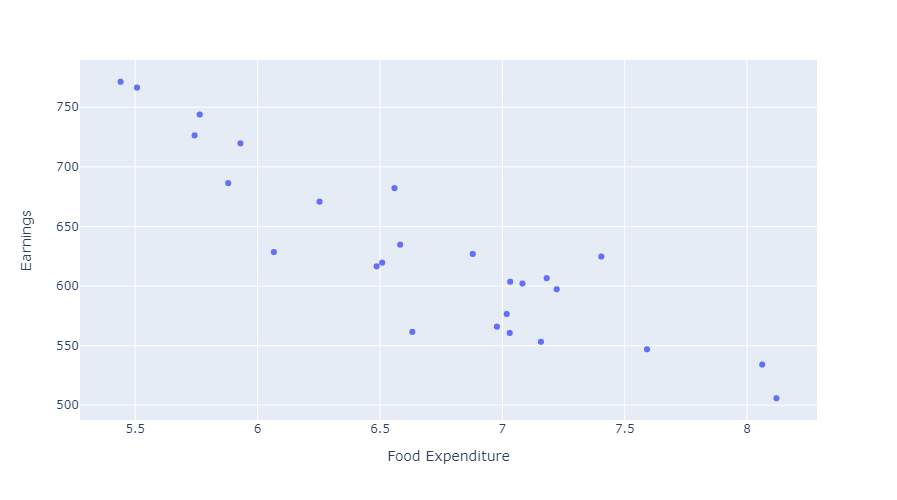

In [55]:
fig = px.scatter(x=merged_borough["food_expenditure"], y=merged_borough["earnings"])
fig.update_layout(
    xaxis_title="Food Expenditure",
    yaxis_title="Earnings",
    showlegend = False,
    height = 500,
    width = 650
)

fig.show()
fig.write_html("figures/earnings_vs_food.html")

We now visualize the differences in the considered wealth indicators accross boroughs.

In [56]:
def plot_london_data(variable, merged_borough, hovertemplate, visible = True):
    merged = map_borough.merge(merged_borough, left_on = 'GSS_CODE', right_on = 'area_id', how = 'inner')
    merged = merged.to_crs(epsg=4326) # convert the coordinate reference system to lat/long
    lga_json = merged.__geo_interface__ #covert to geoJSON
    zmin = merged[variable].min()
    zmax = merged[variable].max()
    name = merged['NAME']

    # Set the data for the map
    data = go.Choroplethmapbox(
            geojson = lga_json,             #this is your GeoJSON
            locations = merged.index,    #the index of this dataframe should align with the 'id' element in your geojson
            z = merged[variable], #sets the color value
            text = merged.NAME,    #sets text for each shape
            colorbar=dict(thickness=20, ticklen=3, tickformat='',outlinewidth=0), #adjusts the format of the colorbar
            marker_line_width=1, marker_opacity=0.7, colorscale="Viridis", #adjust format of the plot
            zmin=zmin, zmax=zmax,           #sets min and max of the colorbar
            hovertemplate=hovertemplate,
            visible = visible)  # sets the format of the text shown when you hover over each shape
    return data

In [57]:
def plot_london_layout():
    MAPBOX_ACCESSTOKEN = 'pk.eyJ1Ijoic29zbzk0IiwiYSI6ImNraTdwem80MDFsNXEyc3FzeGMxOHpoZGkifQ.coIFQU-pN6pZJi0GuXnLVw'
    
    # Set the layout for the map
    layout = go.Layout(
        title = {'font': {'size':24}},  
        mapbox1 = dict(
            domain = {'x': [0, 1],'y': [0, 1]}, 
            center = dict(lat=51.509865 , lon=-0.118092),
            accesstoken = MAPBOX_ACCESSTOKEN, 
            zoom = 8.8),                      
        autosize=True,
        height=650,
        margin=dict(l=0, r=0, t=40, b=0))

    return layout

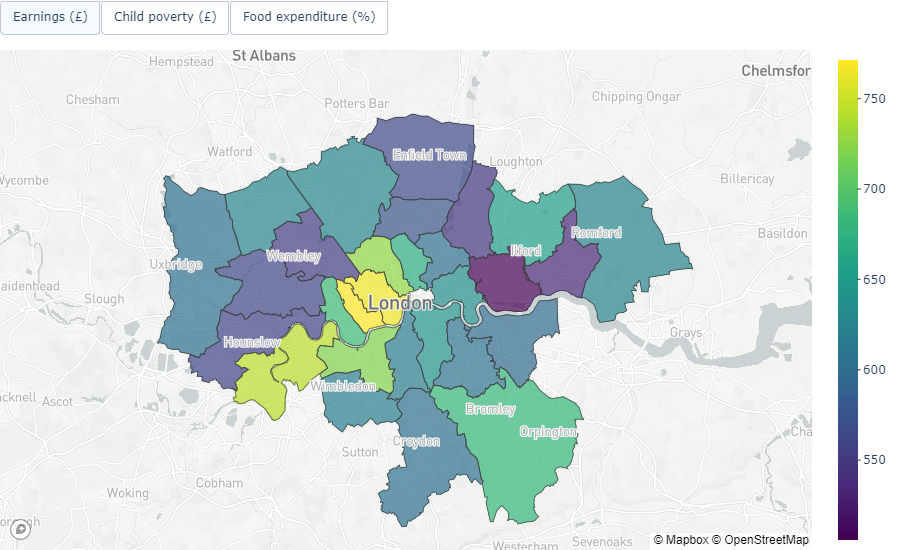

In [58]:
# Convert the food expenditures in percentages
#groceries_expenditure['food_expenditure'] *= 100

# Interactive visualization of London map
plot = go.Figure(data=[plot_london_data('earnings', groceries_earnings,
                                        "<b>%{text}</b><br>"+"%{z:.0f}£<br>"+"<extra></extra>", visible = True), 
        plot_london_data('child_poverty', groceries_poverty, "<b>%{text}</b><br>"+"%{z:.0f}£<br>"+"<extra></extra>",
                        visible = False),
          plot_london_data('food_expenditure', groceries_expenditure,
                           "<b>%{text}</b><br>"+"%{z:.2f}%<br>"+"<extra></extra>", visible = False)],
       layout = plot_london_layout())

plot.update_layout(
    height = 550, width = 900,
    updatemenus=[ 
        dict( 
            active=0,
            x=0.0,
            y=1.1,
            type = "buttons",
            xanchor="left",
             yanchor="top",
             direction="right",
            buttons=list([ 
                dict(label="Earnings (£)", 
                     method="update", 
                     args=[{"visible": [True, False, False]}]), 
                dict(label="Child poverty (£)", 
                     method="update", 
                     args=[{"visible": [False, True, False]}]),
                dict(label="Food expenditure (%)", 
                     method="update", 
                     args=[{"visible": [False, False, True]}])
            ]), 
        ) 
    ]) 
  
plot.write_html("figures/economicindicators_map.html")    
plot.show() 

We compute the correlation between the score 1 and the wealth indicators

In [59]:
features = merged_borough[['score1', 'child_poverty', 'earnings', 'food_expenditure']]
features.corr(method='spearman')

,score1,child_poverty,earnings,food_expenditure
score1,1.000000,-0.613675,0.660855,-0.833846
child_poverty,-0.613675,1.000000,-0.712137,0.618462
earnings,0.660855,-0.712137,1.000000,-0.865299
food_expenditure,-0.833846,0.618462,-0.865299,1.000000


We observe that the score 1 is negatively correlated with the child poverty and positively correlated with the earnings, which is coherent. Child poverty and earnings are negatively correlated, as expected. 
Earnings are negatively correlated with food expenditure, which is in accordance with the Engel's law, an observation in economics which states that as the income increases, the proportion of income spent on food falls, even if the absolute expenditure on food rises. Therefore, it is logical that score 1 and food expenditure are negatively correlated.

In [60]:
# Predict the score 1 by fitting a regression on wealth indicators
features = ['child_poverty', 'earnings', 'food_expenditure']
weights, prediction = find_weights(merged_borough, 'score1')

score1
Training error : 0.016520718435588576, R2 : 0.7225102363759387


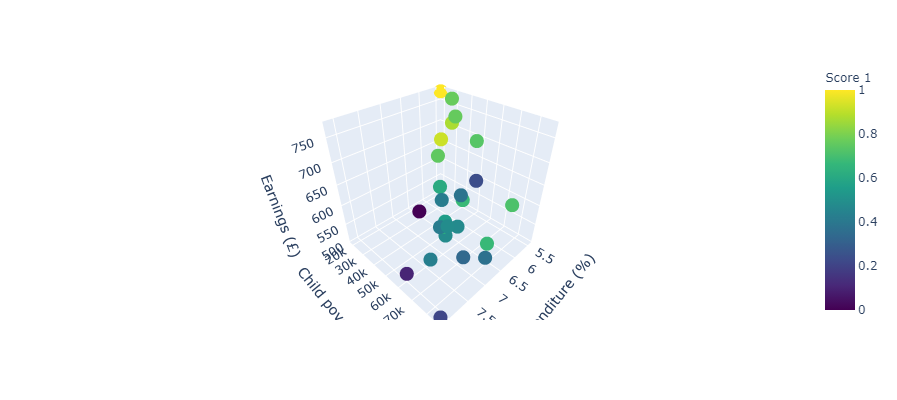

In [61]:
# Scatter visualization in 3-D
fig = px.scatter_3d(merged_borough, x='food_expenditure', y='child_poverty', z='earnings',
              color='score1', color_continuous_scale=px.colors.sequential.Viridis, width=700, height=400,
            labels={"food_expenditure": "Food expenditure (%)",
             "child_poverty": "Child poverty (£)",
             "earnings": "Earnings (£)",
             "score1": "Score 1"})

fig.write_html("figures/scatter3d.html")
fig.show()

Here, it clearly appears again that the higher the earnings and the lower the child poverty, the lower the proportion 
of food expenditures. But more important here, the higher the earnings and the lower the child poverty,
the higher the healthy diet score. So it would be reasonable to think that a healthy diet is clearly positively 
correlated to the borough’s economic situation.